# **Kernel Density Based Clustering**

*   Rohan Niranjan Kalpavruksha
*   Roshan Niranjan Kalpavruksha

## COMPARING **DBSCAN** WITH **VARIOUS KERNEL's** DENSITY BASED CLUSTERING

## Exploratory Data Analysis

In [12]:
import matplotlib
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import pandas as pd
import numpy as np

from tqdm import tqdm

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.datasets import make_blobs
from sklearn.neighbors import KNeighborsClassifier
import plotly.express as px

from ipywidgets import interactive

from collections import defaultdict

import folium
import re


cols = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4',
        '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff',
        '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1',
        '#000075', '#808080']*10

In [16]:
df = pd.read_csv("NYPD Shooting Incident - Data 2006-2021.csv")
df.head(3)

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,JURISDICTION_CODE,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,226323781,3/30/2021,23:45:00,QUEENS,100,0.0,MULTI DWELL - PUBLIC HOUS,False,NaN,NaN,NaN,25-44,M,BLACK,1036867,153432,40.587664,-73.810560,POINT (-73.81055977899997 40.587663570000075)
1,226323779,3/30/2021,16:20:00,BROOKLYN,73,2.0,MULTI DWELL - PUBLIC HOUS,False,25-44,M,BLACK,25-44,M,BLACK,1009548,187629,40.681647,-73.908790,POINT (-73.90879049699998 40.68164709200005)
2,226323782,3/30/2021,23:15:00,BRONX,42,2.0,MULTI DWELL - PUBLIC HOUS,False,NaN,NaN,NaN,18-24,M,BLACK,1012074,240410,40.826510,-73.899465,POINT (-73.89946470899997 40.82650984800006)


In [17]:
df.rename(columns={'Latitude': 'LAT', 'Longitude': 'LON'}, inplace=True)

In [18]:
df.duplicated(subset=['LON','LAT']).values.any()

True

In [19]:
print(f'Before dropping NaNs and dupes\t:\tdf.shape = {df.shape}')
df.dropna(subset=['LON','LAT'],inplace=True)
df.drop_duplicates(subset=['LON','LAT'],keep='first', inplace=True)
print(f'After dropping NaNs and dupes\t:\tdf.shape = {df.shape}')

Before dropping NaNs and dupes	:	df.shape = (23865, 19)
After dropping NaNs and dupes	:	df.shape = (10023, 19)


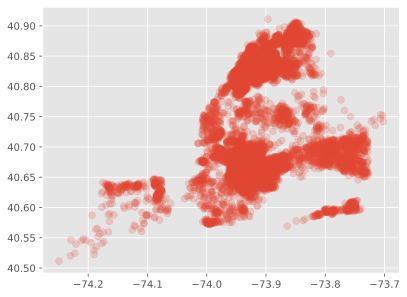

In [20]:
X = np.array(df[['LON','LAT']], dtype='float64')

plt.scatter(X[:,0], X[:,1], alpha=0.2, s=50)

Visualizing Geographical Data

In [21]:
m = folium.Map(location=[df.LAT.mean(), df.LON.mean()])

for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row.LAT,row.LON],
        radius=3, popup=re.sub(r'[^a-zA-z ]+', '', row.BORO),
        color='#1787FE',
        fill=True,
        fill_colour='1787FE'
    ).add_to(m)
m

## 1. DBSCAN

In [38]:
model =DBSCAN(eps=0.01, min_samples=50).fit(X)
class_predictions = model.labels_

df['CLUSTERS_DBSCAN'] = class_predictions

In [39]:
def create_map(df, cluster_column):
    m = folium.Map(location=[df.LAT.mean(), df.LON.mean()])

    for _, row in df.iterrows():

        # get a colour
        cluster_colour = cols[row[cluster_column]]

        folium.CircleMarker(
            location= [row.LAT,row.LON],# insert here,
            radius=5,
            popup= row[cluster_column], # insert here,
            color=cluster_colour,
            fill=True,
            fill_color=cluster_colour
        ).add_to(m)

    return m

m = create_map(df, 'CLUSTERS_DBSCAN')
print(f'Number of clusters found: {len(np.unique(class_predictions))}')
print(f'Number of outliers found: {len(class_predictions[class_predictions==-1])}')

print(f'Silhouette ignoring outliers: {silhouette_score(X[class_predictions!=-1], class_predictions[class_predictions!=-1])}')

m

Number of clusters found: 10
Number of outliers found: 1247
Silhouette ignoring outliers: 0.4677996792124369


## 2. VARIOUS KERNEL's DENSITY BASED CLUSTERING


In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
from sklearn.neighbors import KernelDensity
import folium
import re

# Load the dataset
df = pd.read_csv("NYPD Shooting Incident - Data 2006-2021.csv")
df.rename(columns={'Latitude': 'LAT', 'Longitude': 'LON'}, inplace=True)

# Drop NaNs and duplicates
df.dropna(subset=['LON', 'LAT'], inplace=True)
df.drop_duplicates(subset=['LON', 'LAT'], keep='first', inplace=True)

# Extract coordinates
X = np.array(df[['LON', 'LAT']], dtype='float64')

# Parameters
h = 0.01  # Bandwidth for density estimation
density_threshold_percentile = 80  # Top 80% as high-density points

# Kernel dictionary (sklearn supports predefined kernels)
kernels = ['gaussian', 'tophat', 'epanechnikov', 'exponential', 'cosine']

# Function to perform kernel-based clustering using KernelDensity
def perform_kernel_clustering(kernel):
    # Perform Kernel Density Estimation using sklearn's KernelDensity
    kde = KernelDensity(kernel=kernel, bandwidth=h)
    kde.fit(X)

    # Compute log densities for each point
    log_densities = kde.score_samples(X)
    densities = np.exp(log_densities)  # Convert log densities to actual densities

    # Identify high-density points
    density_threshold = np.percentile(densities, 100 - density_threshold_percentile)
    high_density_points = np.where(densities >= density_threshold)[0]

    # Initialize labels for all points as noise (-1)
    labels = np.full(X.shape[0], -1, dtype=int)
    cluster_id = 0

    # Custom clustering logic for high-density points
    for point_idx in high_density_points:
        if labels[point_idx] != -1:  # Already clustered
            continue
        labels[point_idx] = cluster_id
        queue = [point_idx]

        while queue:
            current_point = queue.pop(0)
            for other_idx in high_density_points:
                if labels[other_idx] != -1:  # Skip already labeled points
                    continue
                distance = np.linalg.norm(X[current_point] - X[other_idx])
                # Check if the points are close enough based on the kernel function
                if np.abs(distance) < h:
                    labels[other_idx] = cluster_id
                    queue.append(other_idx)

        cluster_id += 1

    # Calculate silhouette score for high-density points only
    if len(set(labels[high_density_points])) > 1:  # At least 2 clusters
        silhouette = silhouette_score(X[high_density_points], labels[high_density_points])
    else:
        silhouette = -1  # Not enough clusters for silhouette

    return labels, silhouette, densities

# Plot results for each kernel
plt.figure(figsize=(18, 12))
results = {}
for i, kernel in enumerate(kernels):
    all_labels, silhouette, densities = perform_kernel_clustering(kernel)
    results[kernel] = silhouette

    # Plot clustering results
    plt.subplot(2, 3, i + 1)
    unique_labels = np.unique(all_labels)
    for label in unique_labels:
        if label == -1:
            plt.scatter(X[all_labels == label, 0], X[all_labels == label, 1], s=30, color='gray', label='Noise')
        else:
            plt.scatter(X[all_labels == label, 0], X[all_labels == label, 1], s=30, label=f'Cluster {label}')

    plt.title(f"{kernel.capitalize()} Kernel\nSilhouette Score: {silhouette:.3f}")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.legend()

plt.tight_layout()
plt.show()

# Print silhouette scores
for kernel_name, score in results.items():
    print(f"{kernel_name.capitalize()} Kernel - Silhouette Score: {score:.3f}")


Gaussian Kernel - Silhouette Score: 0.542
Tophat Kernel - Silhouette Score: 0.456
Epanechnikov Kernel - Silhouette Score: 0.438
Exponential Kernel - Silhouette Score: 0.252
Cosine Kernel - Silhouette Score: 0.439
